In [1]:
import numpy as np
import pyspeckit
from pyspeckit.spectrum.models.lte_molecule import get_molecular_parameters
from pyspeckit.spectrum.models import lte_molecule
from astropy import log, constants, units as u
from astropy.table import QTable
import matplotlib.pyplot as plt
import matplotlib
import astropy
from matplotlib.ticker import AutoMinorLocator, MultipleLocator
import matplotlib.patches as mpatches
from astropy.stats import mad_std
from pyspeckit.spectrum.models.lte_molecule import nupper_of_kkms
import pandas
pandas.set_option('display.max_columns', None)
import warnings
warnings.filterwarnings('ignore')
log.setLevel('ERROR')
# from tqdm.auto import tqdm
# from spectral_cube import SpectralCube
# Alternative way to read in spectra (with spectral-cube): 
# https://spectral-cube.readthedocs.io/en/latest/api/spectral_cube.lower_dimensional_structures.OneDSpectrum.html

g++ -std=c++11   -Ofast -fopenmp -DNDEBUG -DHAVE_INLINE -MMD -MP -fPIC   -c -o pwind_geom.o pwind_geom.cpp


In file included from pwind_geom.cpp:2:
pwind_util.H:9:10: fatal error: gsl/gsl_sf_erf.h: No such file or directory
 #include <gsl/gsl_sf_erf.h>
          ^~~~~~~~~~~~~~~~~~
compilation terminated.
make: *** [<builtin>: pwind_geom.o] Error 1


In [2]:
print(np.__version__)
print(pyspeckit.__version__)
print(astropy.__version__)
print(matplotlib.__version__)
print(pandas.__version__)
#print(warnings.__version__)

1.26.4
1.0.4.dev
6.1.7
3.6.2
2.2.3


In [3]:
def plot_full_model(loc, moltbl_fn, figdir, specfns, outdir, write_models=False, plot_noise_range=True, save_figs=False, show_figs=True, export_tbl=False):
    spectra = []
    # Read in the spectra
    for fn in specfns:
        spec = pyspeckit.Spectrum(fn)
        spectra.append(spec)
    # Reorder spectra from lowest to highest frequency
    lowestfreqs = [np.min(spec.xarr).value for spec in spectra]
    correct_order = np.argsort(lowestfreqs)
    spectra_inorder = [spectra[i] for i in correct_order]
    # Read in the molecule table
    tbl = pandas.read_csv(moltbl_fn)
    tbl = tbl[tbl['Index'].notnull()] # Only consider molecules we've found in catalogs
    # Extract info from table, and make sure the provided location is valid
    supported_locs = ['core','frown']
    if type(loc) is not str:
        raise TypeError("The parameter loc must be a string")
    elif loc in supported_locs:
        tbl, inlocs, molnames, specieses, specieses_ltx, catalogs, moltags, v_cens, v_disps, temps, N_tots = extract_from_tbl(loc, tbl)
    elif loc not in supported_locs:
        raise ValueError(f"The provided location is not supported (must be in {supported_locs})")
    # Initialize dict to build into an exportable table later
    tbl_cols = ['mn_tbl', 'spc_tbl', 'spc_ltx_tbl', 'cat_tbl', 'mt_tbl', 'freq_tbl', 'freq_rs_tbl', 'EU_K_tbl', 'aij_tbl', 'qn_tbl', 'peak_tbl',
                'intint_tbl', 'nupper_deg_tbl', 'in_aces_tbl']
    tbl_dict = {key:[] for key in tbl_cols}
    # Gather and plot data and models
    freq_centers_arr = []
    sigma_arr = []
    for spec in spectra_inorder:
        freq_labels, name_labels = [], [] # v_cen_labels
        spec.xarr.convert_to_unit(u.GHz)
        noise = spec.data.std()
        mod = np.zeros(len(spec.xarr))
        # Loop through each molecule
        for (inloc, molname, species, species_ltx, catalog, moltag, v_cen, v_disp, temp, N_tot) in zip(inlocs, molnames, specieses, specieses_ltx, catalogs, moltags, v_cens, v_disps, temps, N_tots):
            try:
                freqs, aij, deg, EU, partfunc, tbl = get_molecular_parameters(molecule_name=None, molecule_tag=moltag, catalog=catalog,
                                                                              parse_name_locally=False, return_table=True,
                                                                              fmin=spec.xarr.min(),
                                                                              fmax=spec.xarr.max()*(1+70/3e5)) # Ensure redshifted lines get plotted
            except TypeError as te:
                continue
            except:
                continue
            # Plot lines of that molecule
            if inloc in ['Y', 'SA', 'ST'] and len(freqs) > 0:
                mod_new = lte_molecule.generate_model(spec.xarr.value*spec.xarr.unit, float(v_cen)*u.km/u.s, float(v_disp)*u.km/u.s, 
                                                      float(temp), float(N_tot), freqs, aij, deg, EU, partfunc)
                # Check if model is producing all NaNs
                if not np.isnan(mod_new).all():
                    if inloc == 'Y': # Only add this line to the model if the molecule is not self-absorbed or subthermally excited
                        mod = np.add(mod, mod_new)
                else:
                    print(f"This molecule is producing all NaNs: {species}")

                tbl.add_column(aij, name='A_ij', index=2)
                for line in tbl:
                    freq = (line['FREQ']*u.MHz).to(u.GHz) # Extract the frequency of the line
                    lgint = line['LGINT']
                    lines = tbl[(tbl['FREQ'] > (freq-0.05*u.GHz)) & (tbl['FREQ'] < (freq+0.05*u.GHz))] # Sample lines nearby (for reducing HFS line crowding)
                    if (lgint >= np.max(lines['LGINT'])) or (species in ['CH3CN', 'CH3CCH']): # Only label if all lines within 0.1 GHz have lower or equal LGINT
                        val = mod_new[np.argmin(np.abs(spec.xarr.to(u.GHz) - freq * (1-float(v_cen)/3e5)))] # Find the model value closest to the redshifted frequency
                        if val > noise/10: # If the model has signal above 1/10 of the noise, count that line in labeling (detections, SA ULs, and ST)
                            freq_labels.append(freq)
                            name_labels.append(species_ltx)
                            # v_cen_labels.append(v_cen)
                            if inloc == 'Y': # Only put the line in the table if it's a detection
                                tbl_dict['mn_tbl'].append(molname) # Name of molecule
                                tbl_dict['spc_tbl'].append(species) # Species
                                tbl_dict['spc_ltx_tbl'].append(species_ltx) # Species in LaTeX format
                                tbl_dict['cat_tbl'].append(catalog) # Catalog
                                tbl_dict['mt_tbl'].append(moltag) # Index
                                tbl_dict['freq_tbl'].append(freq) # Rest frequency
                                freq_rs = freq*(1+float(v_cen)/3e5)
                                tbl_dict['freq_rs_tbl'].append(freq_rs) # Redshifted frequency
                                EL_K = (((line['ELO']*(1./u.cm)*constants.h*constants.c).to(u.erg))/constants.k_B).decompose()
                                EU_K = EL_K + (constants.h*freq)/constants.k_B
                                tbl_dict['EU_K_tbl'].append(EU_K) # Upper state energy in K
                                tbl_dict['aij_tbl'].append(line['A_ij']) # A_ij
                                if catalog == 'CDMS':
                                    if not isinstance(line['vu'], np.ma.core.MaskedConstant):
                                        qn = f"{line['Ju']}({line['Ku']},{line['vu']}) – {line['Jl']}({line['Kl']},{line['vl']})"
                                    elif not isinstance(line['Ku'], np.ma.core.MaskedConstant):
                                        qn = f"{line['Ju']}({line['Ku']}) – {line['Jl']}({line['Kl']})"
                                    else: 
                                        qn = f"{line['Ju']} – {line['Jl']}"
                                elif catalog == 'JPL':
                                    qn_lo = line["QN'"] # NEED TO MAKE JPL QUANTUM NUMBERS LOOK GOOD, PROBABLY BY SLICING UP THE STRINGS
                                    qn_hi = line['QN"']
                                    qn = f"{qn_lo} - {qn_hi}"
                                tbl_dict['qn_tbl'].append(qn) # Quantum numbers
                                peak = spec.data[np.argmin(np.abs(spec.xarr.to(u.GHz) - freq * (1-float(v_cen)/3e5)))] # Find the data value closest to the redshifted frequency
                                tbl_dict['peak_tbl'].append(peak) # Peak intensity
                                ## Section for integrated intensity
                                try:
                                    spec_vel = pyspeckit.Spectrum(xarr=spec.xarr.copy(), data=spec.data)
                                    spec_vel.xarr.convert_to_unit(u.km/u.s, refX=freq, velocity_convention='radio') # This converts ALL spectra into velocity space...
                                    spec_vel_cutout = spec_vel.slice(float(v_cen)*(u.km/u.s) - 4.5*(u.km/u.s), float(v_cen)*(u.km/u.s) + 4.5*(u.km/u.s))
                                    # Calculate integrated intensity (sum slice and multiply by channel width)
                                    slice_sum = spec_vel_cutout.data.sum()*u.K
                                    channel_width = np.abs(spec_vel_cutout.xarr.cdelt())
                                    integrated_intensity = slice_sum*channel_width
                                    spec_vel.xarr.convert_to_unit(u.GHz, refX=freq, velocity_convention='radio') # Need to convert ALL spectra back
                                    tbl_dict['intint_tbl'].append(integrated_intensity) # Integrated intensity
                                except ValueError:
                                    tbl_dict['intint_tbl'].append('ERROR')
                                ## Section for N_upper/deg
                                N_upper = nupper_of_kkms(integrated_intensity, freq, 10**line['A_ij'])
                                tbl_dict['nupper_deg_tbl'].append(N_upper/line['GUP']) # N_upper/deg
                                if 86.5 < freq.value < 100.0: # NEED TO GET THE ACTUAL RANGES
                                    tbl_dict['in_aces_tbl'].append(True)
                                else:
                                    tbl_dict['in_aces_tbl'].append(False)

        # v_cen_labels = np.array(v_cen_labels, dtype=float)

        # Make and write model
        mod = pyspeckit.Spectrum(xarr=spec.xarr.copy(), data=mod)
        if write_models:
            mod_fn = f"/model_{spec.xarr.min().value}_{spec.xarr.max().value}.fits"
            mod.write(outdir+mod_fn, type='fits')

        # Divide the spectrum into two for better visibility
        spec_midpt = ((spec.xarr.to(u.GHz).min().value+spec.xarr.to(u.GHz).max().value)/2)*u.GHz # Calculate midpoint of spectrum
        spec.xarr.convert_to_unit(u.GHz) # Just making sure the conversion worked because of error we got in plotting
        mod.xarr.convert_to_unit(u.GHz) # Just making sure the conversion worked because of error we got in plotting
        spec_LH = spec.slice(spec.xarr.to(u.GHz).min(), spec_midpt)
        spec_UH = spec.slice(spec_midpt, spec.xarr.to(u.GHz).max())
        mod_LH = mod.slice(mod.xarr.to(u.GHz).min(), spec_midpt)
        mod_UH = mod.slice(spec_midpt, mod.xarr.to(u.GHz).max())
        
        freq_center_LH, sigma_LH = plot_spectrum(loc, spec_LH, mod_LH, name_labels, freq_labels, plot_noise_range, save_figs, show_figs) # v_cen_labels
        freq_center_UH, sigma_UH = plot_spectrum(loc, spec_UH, mod_UH, name_labels, freq_labels, plot_noise_range, save_figs, show_figs) # v_cen_labels

        freq_centers_arr.append(freq_center_LH.value)
        freq_centers_arr.append(freq_center_UH.value)
        sigma_arr.append(sigma_LH.value)
        sigma_arr.append(sigma_UH.value)
        
    if export_tbl:
        line_tbl = QTable(tbl_dict) # Renaming columns is not possible...
        # names=('Name', 'Species', 'Species_latex', 'Catalog', 'Index', 'Rest frequency [GHz]', 'Observed frequency [GHz]',
        #        'E_U [K]', 'A_ij','QNs', 'Peak intensity [K]', 'Int. intensity [K km/s]', 'N_upper/deg', 'covered by ACES?')
    
    return line_tbl, freq_centers_arr*freq_center_LH.unit, sigma_arr*sigma_LH.unit

def extract_from_tbl(loc, tbl):
    if loc == 'core':
        tbl = tbl[(tbl['core'] == 'Y') | (tbl['core'] == 'SA') | (tbl['core'] == 'ST')] # Consider detections, ULs, and ST (dets treated special)
        # Export handy columns about the parameters
        inlocs = tbl['core'].to_list()
        moltags = tbl['Index'].astype('int').to_list()
        molnames = tbl['Name'].to_list()
        specieses = tbl['Species'].to_list()
        specieses_ltx = tbl['Species_latex'].to_list()
        catalogs = tbl['Catalog'].to_list()
        # Core-specific
        v_cens = tbl['core \nv_c, km/s'].to_list()
        v_disps = tbl['core\nv_d, km/s'].to_list()
        temps = tbl['core T_rot, K'].to_list()
        N_tots = tbl['core\nN_tot, cm^-2'].to_list()
    elif loc == 'frown':
        tbl = tbl[(tbl['frown'] == 'Y') | (tbl['frown'] == 'SA') | (tbl['frown'] == 'ST')] # Consider detections, ULs, and ST (dets treated special)
        # Export handy columns about the parameters
        inlocs = tbl['frown'].to_list()
        moltags = tbl['Index'].astype('int').to_list()
        molnames = tbl['Name'].to_list()
        specieses = tbl['Species'].to_list()
        specieses_ltx = tbl['Species_latex'].to_list()
        catalogs = tbl['Catalog'].to_list()
        # Frown-specific
        v_cens = tbl['frown T_rot, K'].to_list()
        v_disps = tbl['frown\nv_d, km/s'].to_list()
        temps = tbl['frown T_rot, K'].to_list()
        N_tots = tbl['frown\nN_tot, cm^-2'].to_list()
    return tbl, inlocs, molnames, specieses, specieses_ltx, catalogs,  moltags, v_cens, v_disps, temps, N_tots

def plot_spectrum(loc, spec, mod, name_labels, freq_labels, plot_noise_range, save_figs, show_figs): # v_cen_labels
    # Make new spectrum that is the maximum of both data and model (for line ID plotting)
    maxspec = np.maximum(spec.data, mod.data)
    maxspec = pyspeckit.Spectrum(xarr=spec.xarr, data=np.ma.getdata(maxspec.data))
    # Plot spectrum and model, and plot a "ghost" maxspec (necessary for line IDs)
    fig = plt.figure(figsize=(40, 6))
    gs = fig.add_gridspec(2, hspace = 0, height_ratios = [2, 1])
    axs = gs.subplots(sharex = True, sharey = False)
    spec.plotter(axis=axs[0], figure=fig)
    if loc == 'core':
        mod.plotter(axis=axs[0], clear=False, color='tab:blue')
    elif loc == 'frown':
        mod.plotter(axis=axs[0], clear=False, color='tab:orange')
    maxspec.plotter(axis=axs[0], clear=False, linewidth=0)
    # Plot residuals
    resid = spec - mod
    resid = pyspeckit.Spectrum(xarr=spec.xarr, data=np.ma.getdata(resid.data))
    resid.plotter(axis=axs[1], clear=False)
    axs[1].axhline(linestyle='--', linewidth=0.5, color='grey', alpha=.75)
    # Adjust limits
    axs[0].set_ylim(np.min([spec.plotter.ymin,mod.plotter.ymin]), np.max(([spec.plotter.ymax,mod.plotter.ymax])))
    # Add labels
    axs[1].set_xlabel(f"Frequency [{(spec.xarr.to(u.GHz)).unit}]")
    axs[1].xaxis.set_major_locator(MultipleLocator(0.25))
    axs[1].xaxis.set_minor_locator(MultipleLocator(0.05))
    axs[0].set_ylabel(f"Brightness temperature [K]")
    axs[1].set_ylabel(f"Residual [K]")
    # Make a DIY legend
    code_artist = mpatches.Rectangle([0, 0], 0, 0, fill='grey', color='grey', alpha=.25)
    code_label = r"2$\sigma$ error"
    axs[0].legend(handles = [code_artist], labels = [code_label], loc="lower right", fontsize = 18)
    # Add line IDs
    if loc == 'core':
        maxspec.plotter.line_ids(name_labels, freq_labels*u.GHz, velocity_offset=40*u.km/u.s, plot_kwargs={'color':'red', 'linewidth':0.5}) # v_cen currently overwritten
        # resid.plotter.line_ids(['']*len(name_labels), freq_labels*u.GHz, velocity_offset=40*u.km/u.s, plot_kwargs={'color':'red', 'linewidth':0.5}) # (spec-mod) doesn't work
    elif loc == 'frown':
        maxspec.plotter.line_ids(name_labels, freq_labels*u.GHz, velocity_offset=12*u.km/u.s, plot_kwargs={'color':'red', 'linewidth':0.5}) # v_cen currently overwritten
        # resid.plotter.line_ids(['']*len(name_labels), freq_labels*u.GHz, velocity_offset=12*u.km/u.s, plot_kwargs={'color':'red', 'linewidth':0.5}) # (spec-mod) doesn't work
    if plot_noise_range:
        # Plot a grey rectangle from -2sigma to 2sigma about 0, where sigma is the mad_std from the spectrum
        sigma = mad_std(spec.data)*u.K 
        freq_center = (spec.xarr.to(u.GHz).min() + spec.xarr.to(u.GHz).min())/2.
        axs[0].fill_between(x=axs[0].get_xlim(), y1=2*sigma.value, y2=-2*sigma.value, color='grey', alpha=.25)
        axs[1].fill_between(x=axs[1].get_xlim(), y1=2*sigma.value, y2=-2*sigma.value, color='grey', alpha=.25)
    if save_figs:
        if loc == 'core':
            plt.savefig(figdir+'/'+f'data_model_c_{np.min(spec.xarr.to(u.GHz)).value:07.3f}_{np.max(spec.xarr.to(u.GHz)).value:07.3f}.png', bbox_inches='tight')
            plt.savefig(figdir+'/'+f'data_model_c_{np.min(spec.xarr.to(u.GHz)).value:07.3f}_{np.max(spec.xarr.to(u.GHz)).value:07.3f}.pdf', bbox_inches='tight')
        elif loc == 'frown':
            plt.savefig(figdir+'/'+f'data_model_f_{np.min(spec.xarr.to(u.GHz)).value:07.3f}_{np.max(spec.xarr.to(u.GHz)).value:07.3f}.png', bbox_inches='tight')
            plt.savefig(figdir+'/'+f'data_model_f_{np.min(spec.xarr.to(u.GHz)).value:07.3f}_{np.max(spec.xarr.to(u.GHz)).value:07.3f}.pdf', bbox_inches='tight')
    if show_figs:
        plt.show()
    return freq_center, sigma

In [4]:
moltbl_fn = 'https://docs.google.com/spreadsheets/d/1B4sHLf_wz-8dLeuXcpQO7iRED7mK7Phk61SxGWw5Bok/export?format=csv&gid=1245265514'
figdir = '/blue/adamginsburg/abulatek/brick/first_results/molecule_table/data_model_figs'

results_c = '/blue/adamginsburg/abulatek/brick/symlinks/contsub_smoothed_cubes_K/avg_spectra_core'
results_f = '/blue/adamginsburg/abulatek/brick/symlinks/contsub_smoothed_cubes_K/avg_spectra_frown'
outdir_c = '/blue/adamginsburg/abulatek/brick/first_results/molecule_table/avg_models_core'
outdir_f = '/blue/adamginsburg/abulatek/brick/first_results/molecule_table/avg_models_frown'

# Get list of all spectra
import glob
specfns_c = glob.glob(f"{results_c}/spectrum_*.fits")
specfns_f = glob.glob(f"{results_f}/spectrum_*.fits")

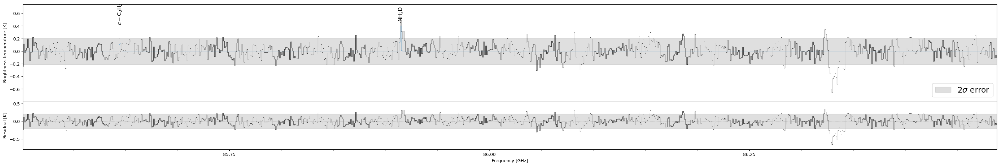

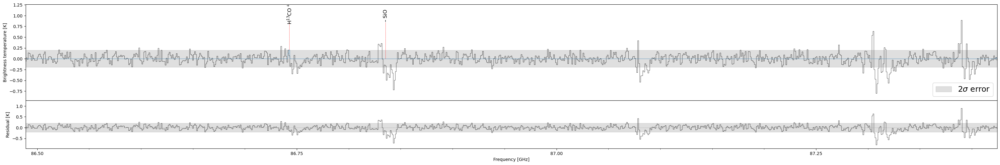

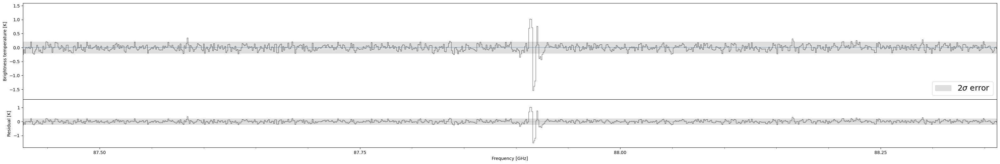

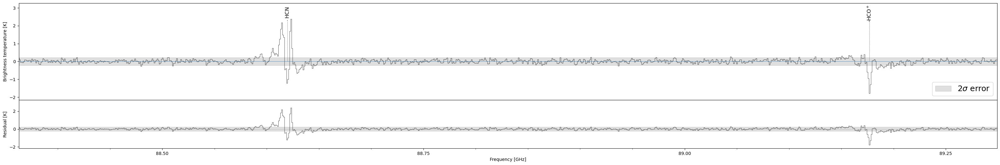

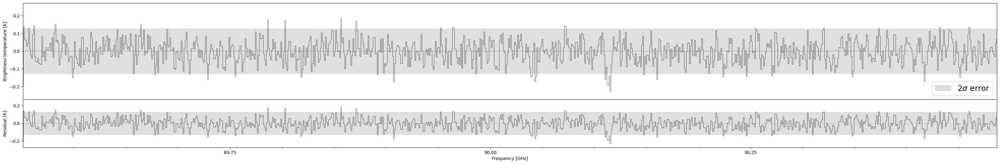

...

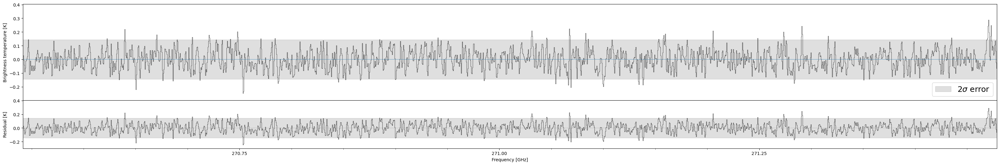

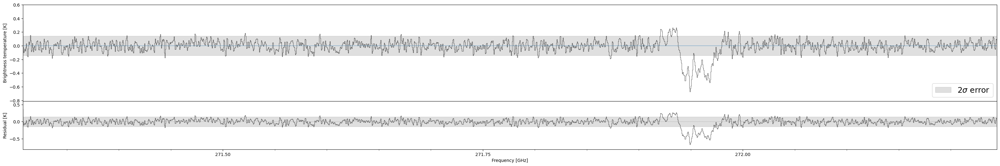

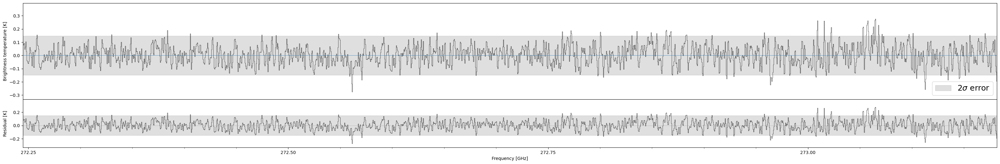

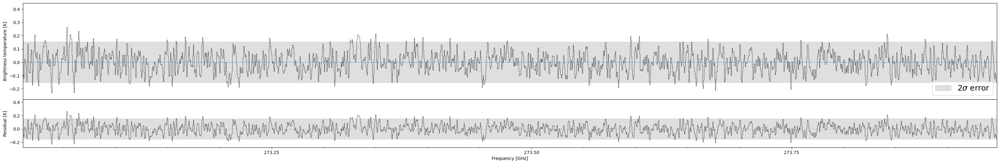

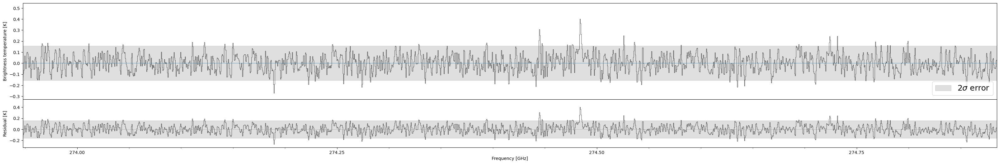

In [5]:
line_tbl_c, freq_centers_c, sigma_c = plot_full_model('core', moltbl_fn, figdir,specfns_c, outdir_c,
                                                      save_figs=False, show_figs=False, export_tbl=True)

This molecule is producing all NaNs: HC5N
This molecule is producing all NaNs: HC5N
This molecule is producing all NaNs: HC5N
This molecule is producing all NaNs: HC5N
This molecule is producing all NaNs: HC5N
This molecule is producing all NaNs: HC5N
This molecule is producing all NaNs: HC5N
This molecule is producing all NaNs: HC5N
This molecule is producing all NaNs: HC5N
This molecule is producing all NaNs: HC5N
This molecule is producing all NaNs: HC5N
This molecule is producing all NaNs: HC5N
This molecule is producing all NaNs: HC5N
This molecule is producing all NaNs: HC5N
This molecule is producing all NaNs: HC5N
This molecule is producing all NaNs: HC5N
This molecule is producing all NaNs: HC5N
This molecule is producing all NaNs: HC5N
This molecule is producing all NaNs: HC5N
This molecule is producing all NaNs: HC5N
This molecule is producing all NaNs: HC5N
This molecule is producing all NaNs: HC5N
This molecule is producing all NaNs: HC5N
This molecule is producing all NaN

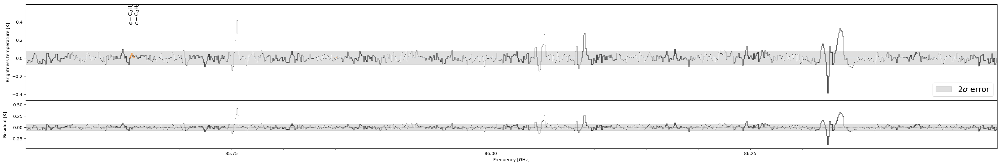

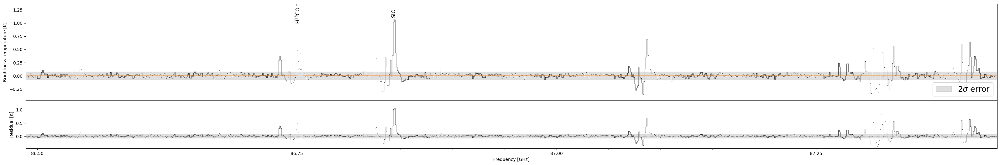

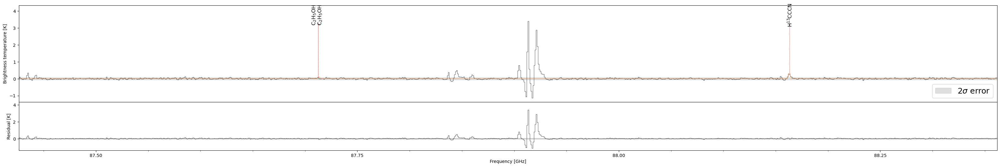

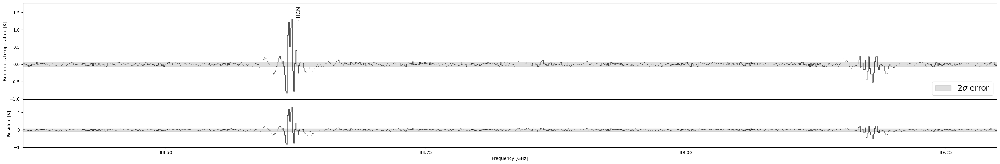

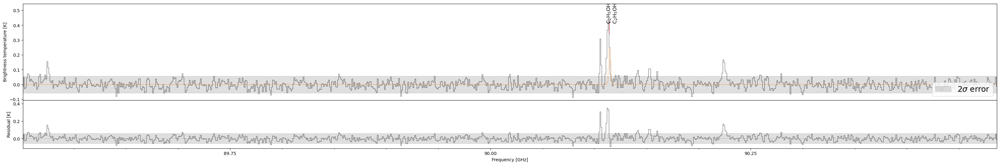

...

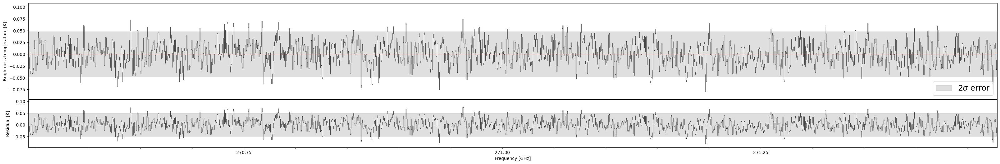

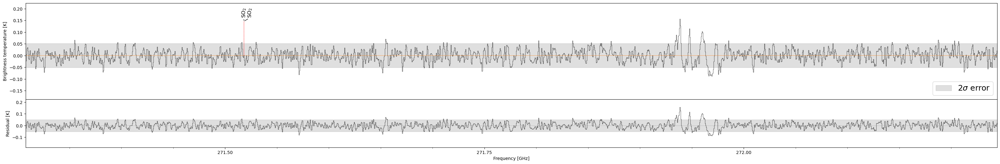

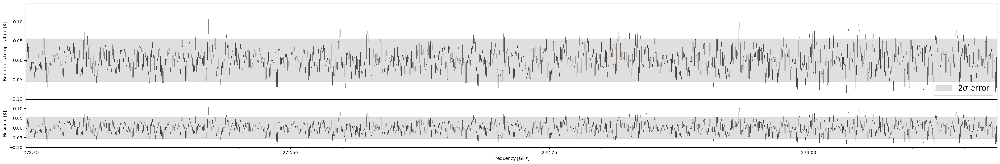

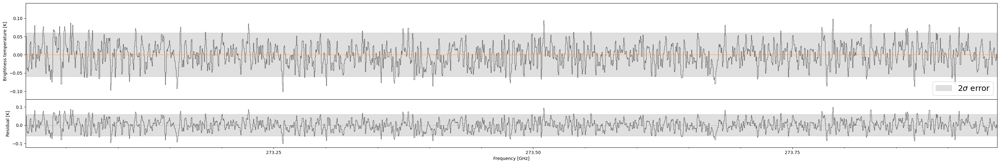

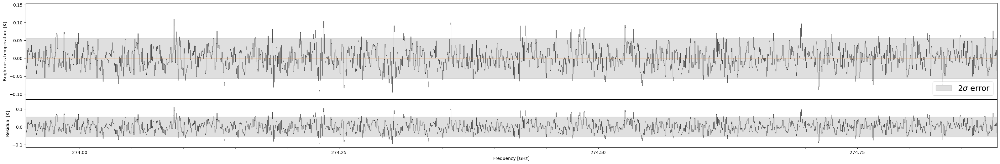

In [6]:
line_tbl_f, freq_centers_f, sigma_f = plot_full_model('frown', moltbl_fn, figdir, specfns_f, outdir_f,
                                                      save_figs=False, show_figs=False, export_tbl=True)

In [7]:
rs_freqs_c = line_tbl_c['freq_rs_tbl']
rs_freqs_f = line_tbl_f['freq_rs_tbl']

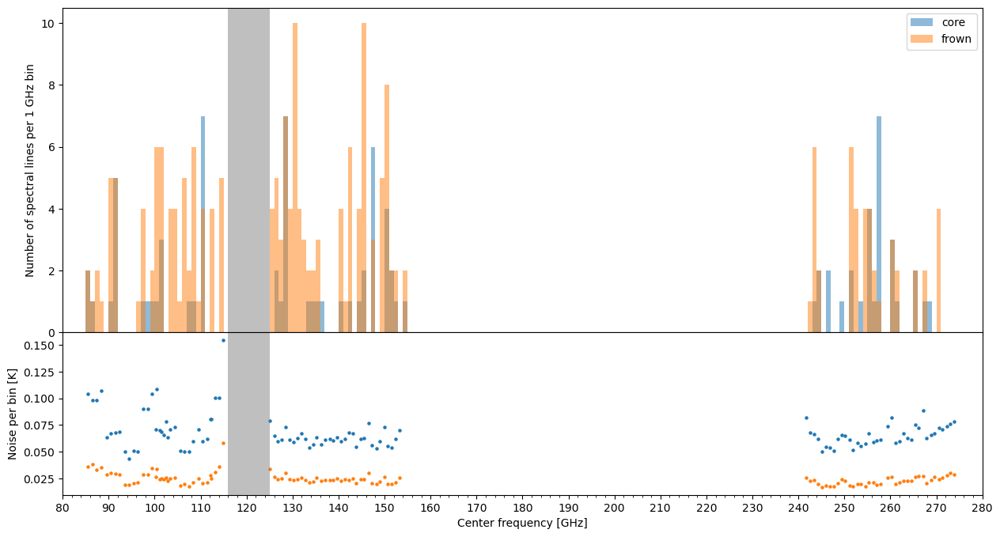

In [8]:
# Make a histogram of number of spectral lines as a function of 1-GHz frequency bins, and noise level per bin
fig = plt.figure(figsize = (15, 8))
gs = fig.add_gridspec(2, hspace = 0, height_ratios = [2, 1])
axs = gs.subplots(sharex = True, sharey = False)

# Plot number of spectral lines per bin
axs[0].hist(rs_freqs_c.value, bins=np.arange(np.floor(rs_freqs_c.value.min()), np.ceil(rs_freqs_c.value.max())+1, 1.), histtype='bar', alpha=0.5, label='core')
axs[0].hist(rs_freqs_f.value, bins=np.arange(np.floor(rs_freqs_f.value.min()), np.ceil(rs_freqs_f.value.max())+1, 1.), histtype='bar', alpha=0.5, label='frown')

axs[1].set_xlim(80, 280)

# Plot noise values
axs[1].scatter(freq_centers_c, sigma_c, s=5)
axs[1].scatter(freq_centers_f, sigma_f, s=5)
noise_axs = axs[1].get_ylim()

# Set ticks and labels
axs[1].xaxis.set_major_locator(MultipleLocator(10))
axs[1].xaxis.set_minor_locator(MultipleLocator(2))
axs[0].set_ylabel('Number of spectral lines per 1 GHz bin')
axs[1].set_ylabel('Noise per bin [K]')
axs[1].set_xlabel('Center frequency [GHz]')

# Put a grey rectange where ALMA can't see between Bands 3 and 4 (116 and 125 GHz)
b34_dead_u = mpatches.Rectangle((116, -0.02), (125. - 116), 20, alpha = 0.5, facecolor = "grey")
b34_dead_l = mpatches.Rectangle((116, -0.02), (125. - 116), 20, alpha = 0.5, facecolor = "grey")
axs[0].add_patch(b34_dead_u)
axs[1].add_patch(b34_dead_l)
axs[1].set_ylim(noise_axs[0],noise_axs[1])

axs[0].legend()

plt.show()

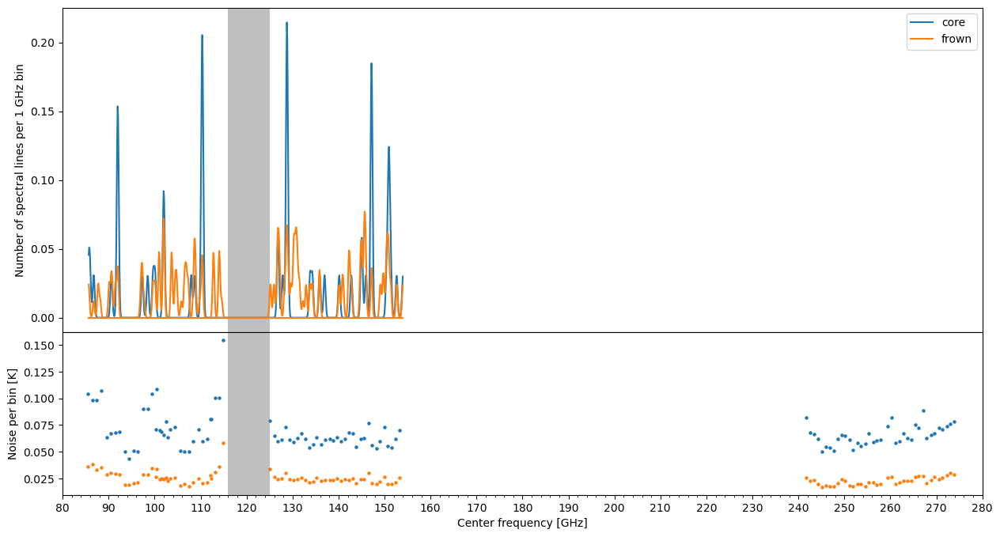

In [9]:
# Make a KDE of number of spectral lines as a function of 1-GHz frequency bins, and noise level per bin
fig = plt.figure(figsize = (15, 8))
gs = fig.add_gridspec(2, hspace = 0, height_ratios = [2, 1])
axs = gs.subplots(sharex = True, sharey = False)

# Split lines into two parts
rs_freqs_c_L = rs_freqs_c[rs_freqs_c.value < 160.]
rs_freqs_c_U = rs_freqs_c[rs_freqs_c.value > 160.]
rs_freqs_f_L = rs_freqs_f[rs_freqs_f.value < 160.]
rs_freqs_f_U = rs_freqs_f[rs_freqs_f.value > 160.]

# Calculate KDEs from histograms, split into two parts
from scipy import stats
kde_c_L = stats.gaussian_kde(rs_freqs_c_L, bw_method=0.01)
kde_c_U = stats.gaussian_kde(rs_freqs_c_U, bw_method=0.01)
kde_f_L = stats.gaussian_kde(rs_freqs_f_L, bw_method=0.01)
kde_f_U = stats.gaussian_kde(rs_freqs_f_U, bw_method=0.01)

# Plot number of spectral lines per bin
xvals = np.arange(rs_freqs_c_L.value.min(), rs_freqs_c_L.value.max(), 0.1)
axs[0].plot(xvals, kde_c_L(xvals), color='tab:blue', label='core')
axs[0].plot(xvals, kde_c_U(xvals), color='tab:blue')
axs[0].plot(xvals, kde_f_L(xvals), color='tab:orange', label='frown')
axs[0].plot(xvals, kde_f_U(xvals), color='tab:orange')

axs[1].set_xlim(80, 280)

# Plot noise values
axs[1].scatter(freq_centers_c, sigma_c, s=5)
axs[1].scatter(freq_centers_f, sigma_f, s=5)
noise_axs = axs[1].get_ylim()

# Set ticks and labels
axs[1].xaxis.set_major_locator(MultipleLocator(10))
axs[1].xaxis.set_minor_locator(MultipleLocator(2))
axs[0].set_ylabel('Number of spectral lines per 1 GHz bin')
axs[1].set_ylabel('Noise per bin [K]')
axs[1].set_xlabel('Center frequency [GHz]')

# Put a grey rectange where ALMA can't see between Bands 3 and 4 (116 and 125 GHz)
b34_dead_u = mpatches.Rectangle((116, -0.02), (125. - 116), 20, alpha = 0.5, facecolor = "grey")
b34_dead_l = mpatches.Rectangle((116, -0.02), (125. - 116), 20, alpha = 0.5, facecolor = "grey")
axs[0].add_patch(b34_dead_u)
axs[1].add_patch(b34_dead_l)
axs[1].set_ylim(noise_axs[0],noise_axs[1])

axs[0].legend()

plt.show()

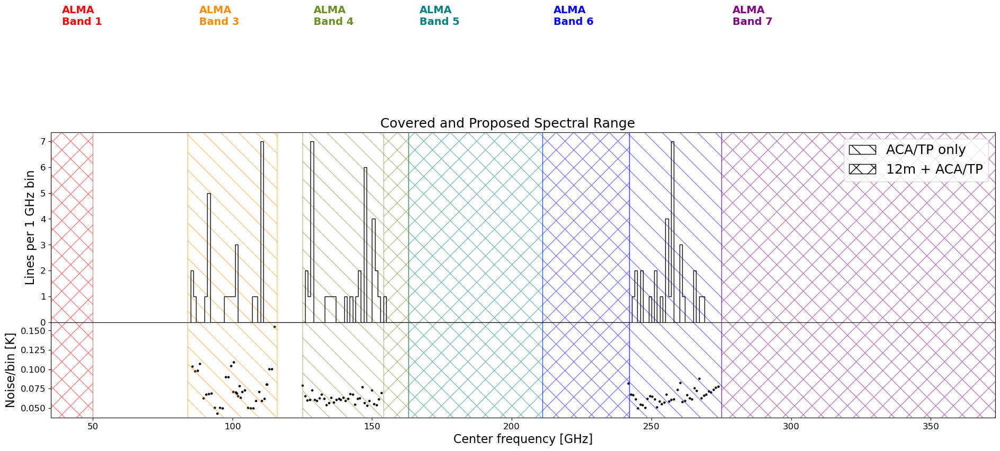

In [10]:
# Use that table for ALMA Cycle 12 resubmission
fig = plt.figure(figsize = (23, 7)) # 23, 7 for ALMA proposal
gs = fig.add_gridspec(2, hspace = 0, height_ratios = [2, 1])
axs = gs.subplots(sharex = True, sharey = False)

fig.suptitle('Covered and Proposed Spectral Range', y = 0.92, fontsize=18)

axs[0].hist(rs_freqs_c.value, bins=np.arange(np.floor(rs_freqs_c.value.min()), np.ceil(rs_freqs_c.value.max())+1, 1.), histtype='step', color='k', label='core')
axs[1].scatter(freq_centers_c, sigma_c, s=5, color='k')

axs[1].set_xlabel('Center frequency [GHz]', fontsize = 16)
axs[0].set_ylabel('Lines per 1 GHz bin', fontsize = 16)
axs[1].set_ylabel('Noise/bin [K]', fontsize = 16)

axs[1].set_xlim(35, 373)

# Label them
axs[0].text(35  + 4, 11.5,  'ALMA\nBand 1', fontsize = 14, color = "red", fontweight = "bold")
axs[0].text(84  + 4, 11.5,  'ALMA\nBand 3', fontsize = 14, color = "darkorange", fontweight = "bold")
axs[0].text(125 + 4, 11.5,  'ALMA\nBand 4', fontsize = 14, color = "olivedrab", fontweight = "bold")
axs[0].text(163 + 4, 11.5,  'ALMA\nBand 5', fontsize = 14, color = "teal", fontweight = "bold")
axs[0].text(211 + 4, 11.5,  'ALMA\nBand 6', fontsize = 14, color = "blue", fontweight = "bold")
axs[0].text(275 + 4, 11.5,  'ALMA\nBand 7', fontsize = 14, color = "purple", fontweight = "bold")

# Add patches for proposed spectral regions (top plot)
# hatch options: '/', '\\', '|', '-', '+', 'x', 'o', 'O', '.', '*'
band1p = mpatches.Rectangle((35, -0.02), (50. - 35.), 20, hatch = 'x', alpha = 0.5, fill = 0, ec = "red") # Band 1 proposed: 12m + ACA
band3p = mpatches.Rectangle((84, -0.02), (116. - 84.), 20, hatch = '\\', alpha = 0.5, fill = 0, ec = "darkorange") # Band 3 proposed: ACA + TP
band4p = mpatches.Rectangle((125, -0.02), (163. - 125.), 20, hatch = '\\', alpha = 0.5, fill = 0, ec = "olivedrab") # Band 4 proposed: ACA + TP
band4p12m = mpatches.Rectangle((154, -0.02), (163. - 154.), 20, hatch = '/', alpha = 0.5, fill = 0, ec = "olivedrab") # Band 4 proposed: 12m (152 - 163 GHz)
band5p = mpatches.Rectangle((163, -0.02), (211. - 163.), 20, hatch = 'x', alpha = 0.5, fill = 0, ec = "teal") # Band 5 proposed: 12m + ACA + some TP
band6p = mpatches.Rectangle((211, -0.02), (242. - 211.), 20, hatch = 'x', alpha = 0.5, fill = 0, ec = "blue") # Band 6 proposed: 12m + ACA (211 - 242 GHz)
band6pACA = mpatches.Rectangle((242, -0.02), (275. - 242.), 20, hatch = '\\', alpha = 0.5, fill = 0, ec = "blue") # Band 6 proposed: ACA + TP (242 - 275 GHz)
band7p = mpatches.Rectangle((275, -0.02), (373. - 275.), 20, hatch = 'x', alpha = 0.5, fill = 0, ec = "purple") # Band 7 proposed: 12m + ACA + TP
# Add patches for proposed spectral regions (bottom plot)
# hatch options: '/', '\\', '|', '-', '+', 'x', 'o', 'O', '.', '*'
band1pn = mpatches.Rectangle((35, -0.02), (50. - 35.), 1, hatch = 'x', alpha = 0.5, fill = 0, ec = "red") # Band 1 proposed: 12m + ACA
band3pn = mpatches.Rectangle((84, -0.02), (116. - 84.), 1, hatch = '\\', alpha = 0.5, fill = 0, ec = "darkorange") # Band 3 proposed: ACA + TP
band4pn = mpatches.Rectangle((125, -0.02), (163. - 125.), 1, hatch = '\\', alpha = 0.5, fill = 0, ec = "olivedrab") # Band 4 proposed: ACA + TP
band4pn12m = mpatches.Rectangle((154, -0.02), (163. - 154.), 1, hatch = '/', alpha = 0.5, fill = 0, ec = "olivedrab") # Band 4 proposed: 12m (152 - 163 GHz)
band5pn = mpatches.Rectangle((163, -0.02), (211. - 163.), 1, hatch = 'x', alpha = 0.5, fill = 0, ec = "teal") # Band 5 proposed: 12m + ACA + some TP
band6pn = mpatches.Rectangle((211, -0.02), (242. - 211.), 1, hatch = 'x', alpha = 0.5, fill = 0, ec = "blue") # Band 6 proposed: 12m + ACA (211 - 242 GHz)
band6pnACA = mpatches.Rectangle((242, -0.02), (275. - 242.), 1, hatch = '\\', alpha = 0.5, fill = 0, ec = "blue") # Band 6 proposed: ACA + TP (242 - 275 GHz)
band7pn = mpatches.Rectangle((275, -0.02), (373. - 275.), 1, hatch = 'x', alpha = 0.5, fill = 0, ec = "purple") # Band 7 proposed: 12m + ACA + TP
# Plot them
axs[0].add_patch(band1p)
axs[0].add_patch(band3p)
axs[0].add_patch(band4p)
axs[0].add_patch(band4p12m)
axs[0].add_patch(band5p)
axs[0].add_patch(band6p)
axs[0].add_patch(band6pACA)
axs[0].add_patch(band7p)
axs[1].add_patch(band1pn)
axs[1].add_patch(band3pn)
axs[1].add_patch(band4pn)
axs[1].add_patch(band4pn12m)
axs[1].add_patch(band5pn)
axs[1].add_patch(band6pn)
axs[1].add_patch(band6pnACA)
axs[1].add_patch(band7pn)

axs[0].tick_params(axis='both', which='major', labelsize=12)
axs[1].tick_params(axis='both', which='major', labelsize=12)

# Make a DIY legend
code_artists = [mpatches.Rectangle([0, 0], 0, 0, fill = 0, hatch = '\\', color='k'), 
                mpatches.Rectangle([0, 0], 0, 0, fill = 0, hatch = 'x', color='k')]
code_labels = ["ACA/TP only", "12m + ACA/TP"]
axs[0].legend(handles = code_artists, labels = code_labels, loc="upper right", fontsize=18)

plt.rcParams.update({
    "figure.facecolor":  'none',
    "axes.facecolor":    'w',
    "savefig.facecolor": 'none'
})

#plt.savefig('/blue/adamginsburg/abulatek/brick/first_results/figures/line_density_proposal_REAL.pdf', facecolor = 'w', edgecolor = 'w', bbox_inches = 'tight')
#plt.savefig('/blue/adamginsburg/abulatek/brick/first_results/figures/line_density_proposal_REAL.png', dpi = 250, bbox_inches = 'tight')
plt.show()